# Importing standard libraries

In [1]:
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=False)
except:
    print("Not in google collab")

Not in google collab


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re

# Acquire data  

The Python Pandas packages helps us work with our datasets. We start by acquiring the dataset into Pandas DataFrame.

In [3]:
try:
    data = pd.read_csv("/content/drive/My Drive/Colab Notebooks/input/imdb_database.csv")
except:
    print("Not in google collab")
    data = pd.read_csv("D:/Onedrive/4 - Documents/1 - Formations/Kaggle/imdb/input/imdb_database.csv")

Not in google collab


Here, we just want a quick grasp to our data. How many rows, how many features ? What type ? How many NaN values ? Where ?  
For that, we'll use several pandas methods like `.info()`, or `.describe` as well as some plots. 

First, let's take a look at our 2 first and last data. 

In [4]:
data.head(2)

,Movie Name,Movie Date,Serie Name,Serie Date,Movie Type,Number of Votes,Movie Revenue (M$),Score,Metascore,Time Duration (min),Director,Actors,Restriction,Description
0,Les évadés,(1994),None,None,Drama,2294987,28341469,9.3,80,142,['Frank Darabont'],"['Tim Robbins', 'Morgan Freeman', 'Bob Gunton'...",Tous publics,Two imprisoned men bond over a number of years...
1,The Dark Knight: Le chevalier noir,(2008),None,None,"Action, Crime, Drama",2259829,534858444,9.0,84,152,['Christopher Nolan'],"['Christian Bale', 'Heath Ledger', 'Aaron Eckh...",Tous publics,When the menace known as the Joker wreaks havo...


In [5]:
data.tail(2)

,Movie Name,Movie Date,Serie Name,Serie Date,Movie Type,Number of Votes,Movie Revenue (M$),Score,Metascore,Time Duration (min),Director,Actors,Restriction,Description
189898,Dragon Ball Z Kai,(2009–2015),The Decisive Battle! Cell vs Son Goku,(2011),"Animation, Action, Adventure",152,None,4.6,None,None,[],"['Masako Nozawa', 'Mayumi Tanaka', 'Ryô Horika...",Tous Public,A Full Powered Super Saiyan Goku fights Cell.
189899,L'Heure de la peur,(2010–2014),A Creature Was Stirring,(2010),"Action, Adventure, Drama",152,None,6.5,None,23,['Terry Ingram'],"['Thomas Robinson', 'Stacy Grant', 'Kurt Evans...",None,Tensions run high when a family receives a mys...


Now a quick description of our data-types, number of rows, features:

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189900 entries, 0 to 189899
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Movie Name           189900 non-null  object 
 1   Movie Date           189895 non-null  object 
 2   Serie Name           189899 non-null  object 
 3   Serie Date           189897 non-null  object 
 4   Movie Type           189900 non-null  object 
 5   Number of Votes      189900 non-null  int64  
 6   Movie Revenue (M$)   189900 non-null  object 
 7   Score                189900 non-null  float64
 8   Metascore            189900 non-null  object 
 9   Time Duration (min)  189900 non-null  object 
 10  Director             189900 non-null  object 
 11  Actors               189900 non-null  object 
 12  Restriction          189900 non-null  object 
 13  Description          189900 non-null  object 
dtypes: float64(1), int64(1), object(12)
memory usage: 20.3+ MB


# Cleaning Data

Our dataset contains **189900 rows** (or entries as the method says) and **14 features** with 3 different types: 
* `object` (usually string)
* `int` (integer)
* `float` (or double in other languages) 

First, lets convert objects type that should be int for float to their correct type.
* convert "None" string values to NaN
* Remove parenthesis from movie date and serie date
* Convert Movie Date, Serie Date, Metascore, Time Duration (min) to float  

Let's also use this time to put our Movie type in List form. We'll need that later on. 

In [7]:
# Renaming Movie Revenue, Time duration and Number of Votes features
data.rename(columns={"Movie Revenue (M$)":"Box Office","Time Duration (min)":"Length", "Number of Votes":"Votes"}, inplace=True)

In [8]:
# Remove Parenthesis from dates
data["Movie Date"] = data["Movie Date"].str.extract(r'([\d]{4})')
data["Serie Date"] = data["Serie Date"].str.extract(r'([\d]{4})')

# Convert Movie Type to list
data["Movie Type"] = data["Movie Type"].str.split(",").apply(lambda x: [y.strip() for y in x])

# Convert "None" string to NaN
mapping = {"None":np.nan}
data.replace(to_replace=["None", None], value=np.nan, inplace=True)

# Convert features to right type
data["Length"] = data["Length"].apply(lambda x: int(x) if type(x) != type(np.nan) else x)
data["Box Office"] = data["Box Office"].apply(lambda x: float(x) if type(x) != type(np.nan) else x)
data["Movie Date"] = data["Movie Date"].apply(lambda x: int(x) if type(x) != type(np.nan) else x)
data["Serie Date"] = data["Serie Date"].apply(lambda x: int(x) if type(x) != type(np.nan) else x)
data["Metascore"] = data["Metascore"].apply(lambda x: int(x) if type(x) != type(np.nan) else x)
data["Score"] = data["Score"].apply(lambda x: int(x) if type(x) != type(np.nan) else x)

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189900 entries, 0 to 189899
Data columns (total 14 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Movie Name   189900 non-null  object 
 1   Movie Date   189895 non-null  float64
 2   Serie Name   65901 non-null   object 
 3   Serie Date   65899 non-null   float64
 4   Movie Type   189900 non-null  object 
 5   Votes        189900 non-null  int64  
 6   Box Office   18946 non-null   float64
 7   Score        189900 non-null  float64
 8   Metascore    18527 non-null   float64
 9   Length       179389 non-null  float64
 10  Director     189900 non-null  object 
 11  Actors       189900 non-null  object 
 12  Restriction  82260 non-null   object 
 13  Description  189900 non-null  object 
dtypes: float64(6), int64(1), object(7)
memory usage: 20.3+ MB


# Initial Look at the data  

In [10]:
data.describe(include=["float64","int64"]).round(1)

,Movie Date,Serie Date,Votes,Box Office,Score,Metascore,Length
count,189895.0,65899.0,189900.0,18946.0,189900.0,18527.0,179389.0
mean,1999.1,2007.4,69206.1,109647985.4,6.9,68.1,73.8
std,20.3,12.9,299178.2,161957314.1,1.4,17.5,51.4
min,1900.0,1951.0,152.0,1.0,1.0,1.0,1.0
25%,1993.0,2003.0,244.0,279314.0,6.1,60.0,42.0
50%,2005.0,2012.0,474.0,21573308.0,7.2,69.0,77.0
75%,2013.0,2016.0,1332.0,171479930.0,8.0,81.0,98.0
max,2020.0,2020.0,2294987.0,760507625.0,10.0,100.0,5220.0


The score, metascore and number of votes seems a bit skewed to the right. Remember, skew to the right, also known as negative skewness means that our data tend not to follow a normal distribution. It is important to check that, as some algorithm tend to deal well with normal data but not with skewed ones. Let's see with a graph. 

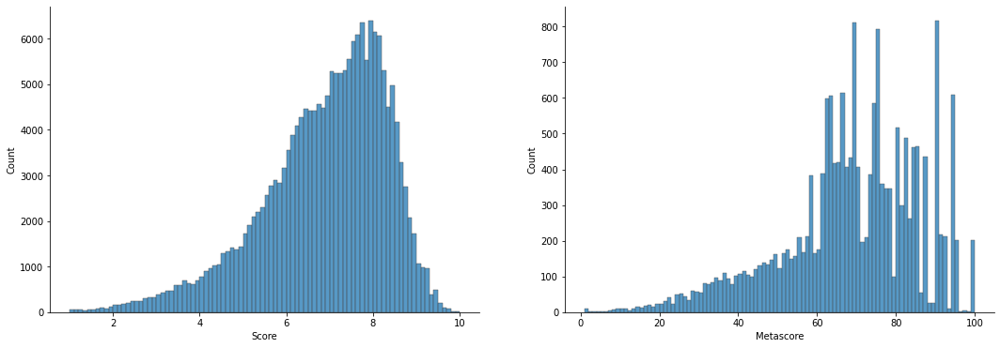

In [11]:
f, ax = plt.subplots(figsize=(18,6), ncols=2)
sns.despine(f)
sns.histplot(
    data.Score,
    palette="light:m_r",
    edgecolor=".3",
    binwidth=0.1,
    kde=False,
    ax=ax[0]
)
sns.histplot(
    data.Metascore,
    palette="light:m_r",
    edgecolor=".3",
    binwidth=1,
    kde=False
)
plt.show()

Because the number of votes is scattered across a wide range. For some reason, there is no number of votes between 15 000 and 90 000. Which mean movies receives less than 20 000 votes or more than 90 000 votes on IMDB.  

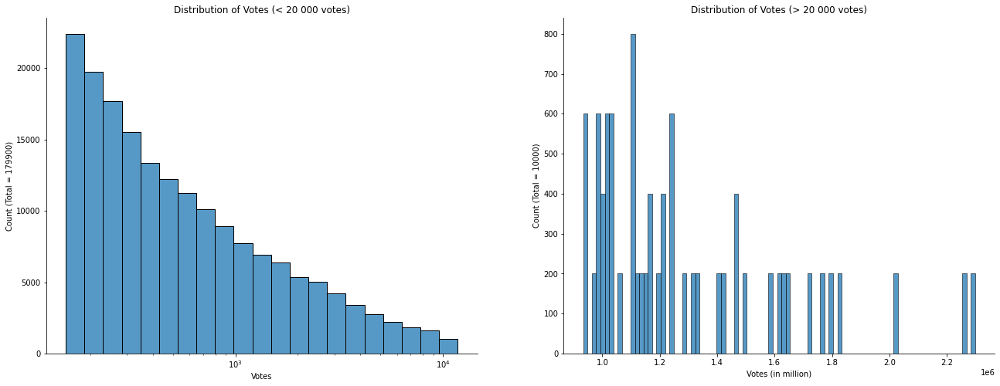

In [12]:
f, ax = plt.subplots(figsize=(22,8), ncols=2)
sns.despine(f)
sns.histplot(
    data["Votes"].loc[data["Votes"] < 20000],
    binwidth=0.09,
    log_scale=True,
    ax=ax[0]
)
sns.histplot(
    data["Votes"].loc[data["Votes"] > 20000],
    binwidth=15000,
    log_scale=[False, False]
)
ax[0].set_ylabel("Count (Total = 179900)")
ax[0].set_title("Distribution of Votes (< 20 000 votes)")

ax[1].set_ylabel("Count (Total = 10000)")
ax[1].set_xlabel("Votes (in million)")
ax[1].set_title("Distribution of Votes (> 20 000 votes)")
plt.show()

Now let's take a look at the time-lenght of films. The length of a film could impact the note given to a movie as well as impact the box office. Who would pay to see a movie that ends after 20 minutes, right ?  
We also want to see if we have shorts or really long films, which could drastically impact our later analysis... 
  
Apparently, we got long and short films. We'll se later if we need to clean that up, but we need to keep it in mind. 

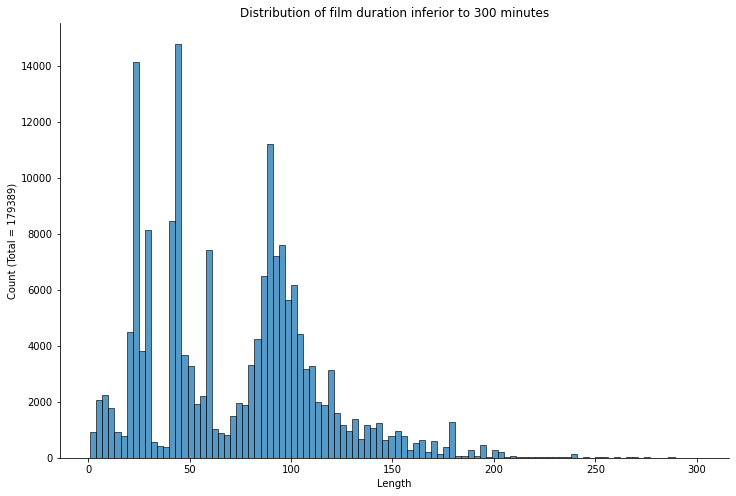

In [13]:
f, ax = plt.subplots(figsize=(12,8))
sns.despine(f)
sns.histplot(
    data["Length"].loc[data["Length"] < 300],
    binwidth=3,
    log_scale=[False, False]
)
ax.set_ylabel("Count (Total = 179389)")
ax.set_title("Distribution of film duration inferior to 300 minutes")
plt.show()

What about the distribution of the variable we try to predict : the box office. 

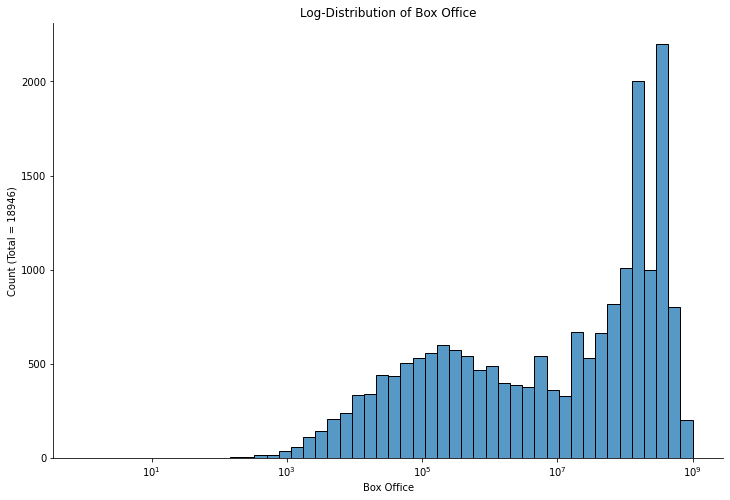

In [14]:
f, ax = plt.subplots(figsize=(12,8))
sns.despine(f)
sns.histplot(
    data["Box Office"].loc[data["Box Office"] < 1000000000],
    binwidth=0.18,
    log_scale=[True, False]
)
ax.set_ylabel("Count (Total = 18946)")
ax.set_title("Log-Distribution of Box Office")
plt.show()

Finally lets take a look to the features with string element 

In [15]:
data.describe(include=["object"])

,Movie Name,Serie Name,Movie Type,Director,Actors,Restriction,Description
count,189900,65901,189900,189900,189900,82260,189900
unique,106535,52657,1965,44100,121359,31,170673
top,Les Simpson,Pilot,[Comedy],[],[],Tous publics,Add a Plot
freq,690,560,15058,20480,2437,31985,3036


Many of the restrictions are identical with typo or different name. After checking with USA and Europe laws, we can come up with those categories (cf. https://en.wikipedia.org/wiki/Motion_picture_content_rating_system")




In [16]:
mapping = {"Tous publics":"G-rated", "Tous publics":"G-rated", "Tous publics avec avertissement":"G-rated", "Approved":"G-rated", "7":"G-rated", "G":"G-rated", "12 avec avertissement":"PG13", "PG-13":"PG13", "13":"PG13", "12":"PG13", "10":"PG", "TV-PG":"PG", "M/PG":"PG", "GP":"PG", "16":"R-rated", "R":"R-rated", "Not Rated":"Not Rated", "NC-17":"NC17", "Unrated":"Not Rated", "18":"NC17", "(Banned)":"Banned", "X":"NC17"}

data["Restriction"] = data.Restriction.map(mapping)

data = data.loc[data["Restriction"] != "Banned"]

In [17]:
data["Restriction"].unique()

array(['G-rated', 'R-rated', 'PG13', nan, 'NC17', 'Not Rated', 'PG'],
      dtype=object)

Now let's see if this restriction is correlated to the variable we try to predict: 

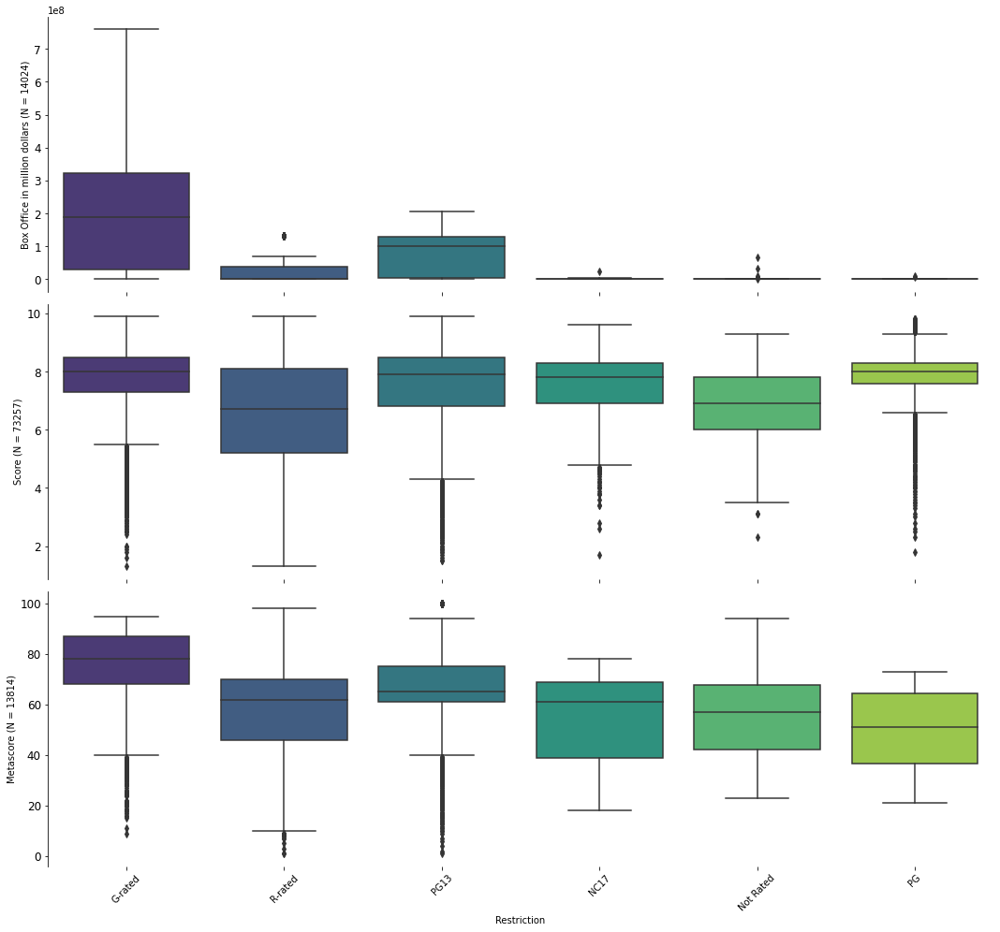

In [18]:
f, ax = plt.subplots(figsize=(15,14), nrows = 3, sharex=True, sharey=False)
sns.set_context( rc={"font.size":12,"axes.titlesize":12,"axes.labelsize":10,})  
sns.despine(offset=0, trim=False, bottom=True, left=False)
sns.boxplot(x="Restriction", y="Box Office", palette="viridis",
            data=data, ax=ax[0])
sns.boxplot(x="Restriction", y="Score", palette="viridis",
            data=data, ax=ax[1])
sns.boxplot(x="Restriction", y="Metascore", palette="viridis",
            data=data)
ax[0].set_xlabel("")
ax[1].set_xlabel("")
ax[2].set_xlabel("Restriction")
ax[0].set_ylabel("Box Office in million dollars (N = 14024)")
ax[1].set_ylabel("Score (N = 73257)")
ax[2].set_ylabel("Metascore (N = 13814)")
plt.xticks(rotation= 45)
plt.tight_layout()

In [19]:
data.loc[:,['Restriction','Box Office', 'Score', 'Metascore']].groupby(["Restriction"]).agg(["count","mean","median","std"]).round(1)

Box Office                                         Score       \
                 count         mean       median          std  count mean   
Restriction                                                                 
G-rated           8159  214580995.1  188020017.0  194635799.5  33984  7.8   
NC17                10    3049527.2     347748.0    7754197.9    791  7.5   
Not Rated           58    2238387.6     166976.0    9492309.5    329  6.9   
PG                  11    1771686.5     252895.0    3216844.8  10803  7.9   
PG13              3247   77552580.3  100125643.0   67914225.3  13481  7.5   
R-rated           2537   23557846.6     727430.0   38432669.3  13861  6.5   

                        Metascore                     
            median  std     count  mean median   std  
Restriction                                           
G-rated        8.0  1.0      7988  76.4   78.0  13.0  
NC17           7.8  1.2        15  53.7   61.0  18.8  
Not Rated      6.9  1.3        62  56.6   57.0  16.3  
PG             8.0  0.7        11  49.0   51.0  17.4  
PG13           7.9  1.3      3118  66.9   65.0  17.7  
R-rated        6.7  1.8      2619  59.3   62.0  19.3

Metascore and Score are Higly correlated. We can see them with a lm plot. To assess their relationship, we also used Restriction as a grouping variable. As we can see, their regression line are almost reproducing a 1-to-1 ratio (which would be expected if we had a correlation of 1 or close to 1). Which mean there is a **high risk** of collinearity, and one of those variable should be dropped in further analysis. 

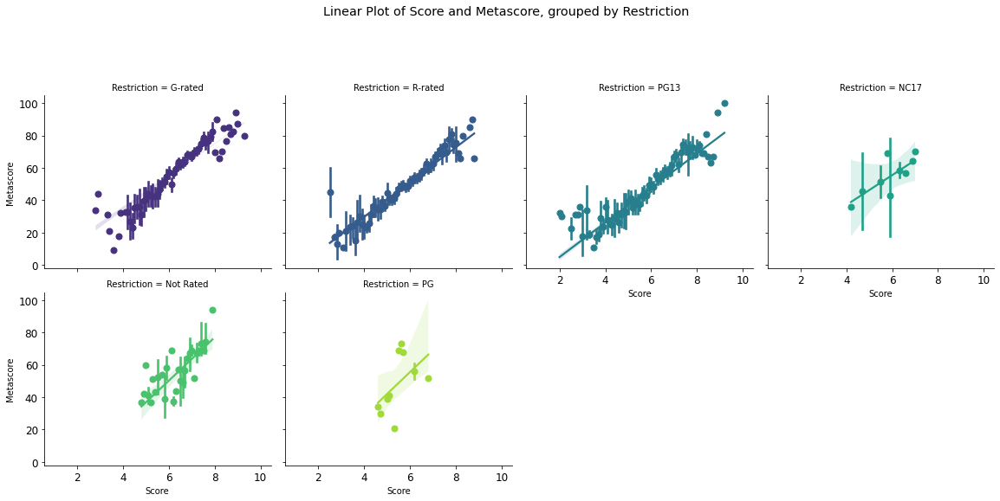

In [20]:
g = sns.lmplot(x="Score", y="Metascore", hue="Restriction", data=data,
               palette="viridis", col="Restriction", x_estimator=np.mean, col_wrap=4, height=4)
plt.subplots_adjust(top=0.8)
g.fig.suptitle("Linear Plot of Score and Metascore, grouped by Restriction")
plt.show()

Finally, let's look at our correlation table: 
* Score and metascore are closely correlated (r = 0.758)
* Box Office and Vote are correlated (r = 0.576)
* Box Office and Score are correlated (r = 0.49)
* Box Office and length are correlated (r = 0.524)

We also have 1 correlation that could be checked : 
* Box office and Serie Date. Does this mean that recent Series made less money than older series ?

In [21]:
data.corr()

,Movie Date,Serie Date,Votes,Box Office,Score,Metascore,Length
Movie Date,1.000000,0.930453,0.008262,0.119974,0.060932,-0.266357,-0.015599
Serie Date,0.930453,1.000000,0.104781,-0.262428,0.102014,0.049522,0.056475
Votes,0.008262,0.104781,1.000000,0.637813,0.263872,0.576371,0.318545
Box Office,0.119974,-0.262428,0.637813,1.000000,0.493574,0.402782,0.524051
Score,0.060932,0.102014,0.263872,0.493574,1.000000,0.757613,-0.179326
Metascore,-0.266357,0.049522,0.576371,0.402782,0.757613,1.000000,0.481140
Length,-0.015599,0.056475,0.318545,0.524051,-0.179326,0.481140,1.000000


In [22]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Scatter(x=data["Movie Date"],
                                y=data['Box Office'],
                                mode='markers',
                                marker_color=data['Box Office'],
                                text=data['Movie Name'])) # hover text goes here
fig.show()

# Feature engineering

Now its te time to deal with our data for real. As we saw with our previous data exploration, we need to deal with many features: 
* Choosing between score and metascore as they are higly correlated and we might encounter collinearity problem usign both of them. We'll also need to standardize, remove outliers and so on. 
* Fix our `Restriction feature`. 
    * It seems that G-Rated movies tend to have a broader and higher box office income than other movies. Which mean it could be a good idea to implement it into our final analysis. But we have 18k observations for our Box office Y-feature, and only  14k observations for our Restriction X-feature. We therefore got 2 choices. Either we accept to loose 4000 observations on our Y-feature to match our X-feature. Or we can try to "guess" the rating of those movies with some kind of technics. We'll also need to drop irrelevant categories or merge them into an "other" category. 
    * This lead to an other "problem" --> How do we guess those ratings ? Well, we could check by hand for each of the 4000 movies, and hope to find information online. Or we could use the latest progress in deeplearning classification algorithms and guess the rating using an other feature of the dataset. I'll let you guess which one.... The Movie description feature of course !
* So now, we also need to fix our Description feature. Remove short descriptions (like the description "Add a plot", which is not relevent for us), lemmatize, tokenize, and pad our data. (i'll explain later what those terms means but for now, see it as a cleaning and normalizing procedure)
* Choosing limits for our movie length. We do not want to keep series, nor anime, nor film that are too long and could be categorized as independent and/or experimental movie (one of them got a length of more than 1 day !)
* For director and actors, we might use OneHot encoding technic to transform those categorical into numerical variables. We'll need to dig the relationship between those features and the box office feature, but we can already suppose that well-known actors (or actors with experience) as well as well-known directors will impact, in some extend, our box office. And maybe well-known directors only produces movies with well-knows actors in it. In which case we could keep only one of those 2 features. 

### Keras and Tensorflow (WIP)

First, let's check our movies-descriptions that has a low amount of words. We saw earlier that some had the sentence 'Add a plot' in it. It might be a good idea to remove those unwanted description from our analysis. We therefore check the number of sentences in `Description` that have less than 30 words. 

In [23]:
data_lstm = data.copy()
data_lstm.drop_duplicates(subset=["Description","Restriction"], inplace=True)
# # 5 categories 
mapping = {"G-rated":"Grated", "PG13":"PG13", "PG":"PG", "Not Rated":"Unrated", "NC17":"NC17", "R-rated":"Rrated"}
data_lstm["Restriction"] = data_lstm.Restriction.map(mapping)
# Drop NaN
data_lstm.dropna(subset=["Restriction"], inplace=True)


# Remove "see full sumary" option in description
data_lstm["Description"] = data_lstm["Description"].apply(lambda x: x.strip("See full summary »"))
data_lstm["Description"] = data_lstm["Description"].apply(lambda x: x.strip())
data_lstm["Description"] = data_lstm["Description"].apply(lambda x: x.strip("See full summary"))


In [24]:
data_lstm["Restriction"].value_counts()

Grated     26215
Rrated     12564
PG13       10673
PG         10409
NC17         764
Unrated      317
Name: Restriction, dtype: int64

In [25]:
data_lstm["Restriction"].unique()

array(['Grated', 'Rrated', 'PG13', 'NC17', 'Unrated', 'PG'], dtype=object)

In [26]:
data_lstm.loc[data_lstm.Description.apply(lambda x: len(x.split(' '))) > 20, "Description"].count()

47738

In [27]:
data_lstm.loc[data_lstm.Description.apply(lambda x: len(x.split(' '))) > 40, "Description"].count()

2900

In [28]:
data_lstm.loc[data_lstm.Description.apply(lambda x: len(x.split(' '))) > 75, ["Description"]].value_counts()

Description                                                                                                                                                                                                                                                                                                                                                                                                       
In a plan to remove all suspicions from himself, Light tells L that he thinks he may be Kira subconsciously and asks to be confined. Light's father believes it is also a good idea to be confined to a cell as well as he cannot risk his emotions getting the better of him. In confinement, Light gives Ryuk the order to have his memory wiped, leaving L confused now that his two suspects both register ...    1
Accidents Will Happen: When Squidward gets hurt on the job, he threatens to take legal action unless Mr. Krabs agrees to cater to him hand and foot. Mr. Krabs and Plankton find a common ene

In [29]:
data_lstm = data_lstm.loc[data_lstm.Description.apply(lambda x: len(x.split(' '))) > 20, :]

In [30]:
try:
    f = open("/content/drive/My Drive/Colab Notebooks/input/glove.6B.100d.txt")
except FileNotFoundError:
    print("Not in google colab")
    f = open("D:/Onedrive/4 - Documents/1 - Formations/Kaggle/imdb/input/glove.6B.100d.txt")

Not in google colab


In [31]:
import sys
sys.path.append('/content/drive/My Drive/Colab Notebooks/')
from datafunc import tslm
print(tslm.__file__)

length = 75
vocab_size = 10000
labels, embedding_matrix, train_padded, training_label_seq, validation_padded, validation_label_seq, test_padded, test_label_seq = tslm.data_preprocessing(data_lstm, length, vocab_size)

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Pierr\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Pierr\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Pierr\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
d:\Onedrive\4 - Documents\1 - Formations\Kaggle\imdb\datafunc\tslm.py

Parameters:
   Max padding length: 75
   Vocabulary size: 10000
   Using oov: True

-Preparing data
-Removing NaN Values from the restriction feature
--Splitting into train-test set
---Preparing labels, train/test/val Restriction (labels) and description (articles)
----Tokenizing and padding description data
-----Tokenizing and padding labels data
------Converting words to sequence of numbers
-------Padding train/test/val data
--------Reseting index
-------

In [31]:
# import tensorflow as tf
# from tensorflow.python.client import device_lib

# print(tf.config.list_physical_devices('GPU'))
# print("\n")

In [35]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.layers import Dense, LSTM, Bidirectional, Embedding, SpatialDropout1D, Dropout
from tensorflow.keras.optimizers import Adam, Nadam, RMSprop
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.models import load_model
from tensorflow.keras import Sequential

from sklearn.utils import class_weight

# Do not set all gpu memory at start
try:
  tf.config.experimental.set_memory_growth(physical_devices[0], True)
except:
  # Invalid device or cannot modify virtual devices once initialized.
  pass



# Class weights
weights = class_weight.compute_class_weight('balanced',
                                                 np.unique(training_label_seq),
                                                 np.concatenate(training_label_seq))
weights = {i : weights[i] for i in range(len(np.unique(training_label_seq)))}

# Embedding dimensions
input_dims = len(embedding_matrix)
output_dims = 64 
max_length = length

# Model construction
lstm_outs = 200
drop_rates = 0.2

# Optimizer
learning_rate_optimizer_opts = 0.001
optimizer_name_opts = "Adam"

# Regularizer
regularizer_opt = "None"
regularizer_rate_opt = 0.001

# Model Fit
epoch_opt = 2000
batch = 32



# Define model keras
def model_keras(input_dim, output_dim, max_length, lstm_out, drop_rate, 
                learning_rate_optimizer, optimizer_name, regularizer, 
                regularizer_rate, embedding_matrix):

    # Choose regularize
    if optimizer_name == 'l2':
        reg = l2(l = regularizer_rate)
    elif optimizer_name == 'l1':
        reg = l1(l = regularizer_rate)
    else:
        reg = None

    # Model construction
    model = Sequential([
        Embedding(input_dim=len(embedding_matrix), output_dim=100, input_length=max_length, weights = [embedding_matrix], trainable=False),
        SpatialDropout1D(drop_rate),
        Bidirectional(LSTM(lstm_out, kernel_regularizer = reg, return_sequences=True)),
        SpatialDropout1D(drop_rate),
        Bidirectional(LSTM(lstm_out, kernel_regularizer = reg, return_sequences=True)),
        SpatialDropout1D(drop_rate),
        Bidirectional(LSTM(lstm_out, kernel_regularizer = reg, return_sequences=True)),
        SpatialDropout1D(drop_rate),
        Bidirectional(LSTM(lstm_out, kernel_regularizer = reg, return_sequences=True)),
        SpatialDropout1D(drop_rate),
        Bidirectional(LSTM(lstm_out, kernel_regularizer = reg)),
        Dense(len(labels.unique()), activation='softmax'),
    ])

    # Optimizer 
    if optimizer_name == 'Adam':
        opt = Adam(learning_rate=learning_rate_optimizer)
    elif optimizer_name == 'Nadam':
        opt = Nadam(learning_rate=learning_rate_optimizer)
    else:
        opt = RMSprop(learning_rate=learning_rate_optimizer)

    # Compilation
    model.compile(loss='sparse_categorical_crossentropy', 
                  optimizer=opt, 
                  metrics=['accuracy'])

    return model


# Call model
model = model_keras(input_dim = input_dims, 
                    output_dim = output_dims, 
                    max_length = length, 
                    lstm_out = lstm_outs, 
                    drop_rate = drop_rates, 
                    learning_rate_optimizer = learning_rate_optimizer_opts, 
                    optimizer_name = optimizer_name_opts, 
                    regularizer = regularizer_opt,
                    regularizer_rate = regularizer_rate_opt,
                    embedding_matrix = embedding_matrix)
model.summary()


# Early Stopping
es = EarlyStopping(monitor = 'val_loss',
                   min_delta = 0,
                   patience = 30,
                   verbose = 1,
                   restore_best_weights = False)

# CheckPoint
mcp_save = ModelCheckpoint('/model/.mdl_wts.hdf5', 
                           save_best_only=True, 
                           monitor='val_loss', 
                           mode='min')

# Reduce learning rate on plateau
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', 
                                   factor=0.1, 
                                   patience=7, 
                                   verbose=1, 
                                   min_delta=1e-5, 
                                   mode='min')

# Model Fit
print("\n\nEpoch generation","_"*48)
with tf.device('/gpu:0'):
    history = model.fit(x = train_padded, 
                    y = training_label_seq, 
                    epochs = epoch_opt, 
                    batch_size = batch, 
                    class_weight = weights, 
                    validation_data = (validation_padded, validation_label_seq), 
                    verbose = 2, 
                    use_multiprocessing = True, 
                    callbacks = [es, mcp_save, reduce_lr_loss])

# Load the best model
model = load_model(".mdl_wts.hdf5")

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 75, 100)           3803200   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 75, 100)           0         
_________________________________________________________________
bidirectional (Bidirectional (None, 75, 400)           481600    
_________________________________________________________________
spatial_dropout1d_1 (Spatial (None, 75, 400)           0         
_________________________________________________________________
bidirectional_1 (Bidirection (None, 75, 400)           961600    
_________________________________________________________________
spatial_dropout1d_2 (Spatial (None, 75, 400)           0         
_________________________________________________________________
bidirectional_2 (Bidirection (None, 75, 400)           9

KeyboardInterrupt: 

In [ ]:
train_acc = model.evaluate(train_padded, training_label_seq, verbose=0)
test_acc = model.evaluate(validation_padded, validation_label_seq, verbose=0)
print('----Model mesure----\nTrain:\n   acc: %.3f\nTest:\n   acc: %.3f' % (train_acc[1], test_acc[1]))

In [ ]:
def plot_graphs(history, string):
    plt.figure(figsize=(10,6))
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()
  
plot_graphs(history, "accuracy")
plot_graphs(history, "loss")

In [ ]:
txt = ["A boy discovers an incredible and gruesome wor."]


seq = tokenizer.texts_to_sequences(cleanedPredData)
padded = pad_sequences(seq, maxlen=max_length)
pred = model.predict(padded, verbose=1)
labels = cleanedData["Restriction"].unique()
# print(pred, labels[np.argmax(pred)])

In [ ]:
predicted_values = pd.DataFrame(pred, columns=labels)
predicted_values

# Références 

Olga Troyanskaya, Michael Cantor, Gavin Sherlock, Pat Brown, Trevor Hastie, Robert Tibshirani, David Botstein and Russ B. Altman, Missing value estimation methods for DNA microarrays, BIOINFORMATICS Vol. 17 no. 6, 2001 Pages 520-525. 

McInnes, L., Healy, J., & Melville, J. (2020). UMAP : Uniform Manifold Approximation and Projection for Dimension Reduction. arXiv:1802.03426 [cs, stat]. http://arxiv.org/abs/1802.03426

